# Richter's Predictor: Modeling Earthquake Damage

**Overview**

Recently, on 6 February, 2023 a deadly earthquake of 7.8 magnitude scale was struck on Turkey near the Syrian border. The earthquake had a fault line of 100km that caused serious damages to the surrounding areas. Turkey and Syria have witnessed one of the largest and deadliest earthquake in their country, total of two big earthquake of magnitude 7.8 and 7.5 and multiple smaller earthquake and regular after-shocks have caused causualties and destruction in large scale.

Understanding and predicting natural calamities is one the most challenging study in the field of machine learning, for this we can take a step at a time and learn all the factors related to this natural calamities and apply certain precautions from our learnings. Similar to the current events of the Turkey-Syria Earthquake, in 2015 Nepal had witnessed a Earthquake of 7.8 magnitude scale called the Gorkha Earthquake, this earthquake caused more than 8900 deaths and a destruction that costed nepal half of it's GDP. 

After the earthquake the Nepal Government carried out survey using mobile technology to assess the damage caused by the earthquake. This survey was considered as one of the largest data collection post natural disaster, collecting data on earthquake damage, housing conditions and socio-economic information. The data is available for the public on the website https://eq2015.npc.gov.np/#/ and to read the details of the 2015 Nepal Earthquake and 2023 Turkey-Syria Earthquake you can visit here - [Nepal Earthquake - Wikipedia](https://en.wikipedia.org/wiki/April_2015_Nepal_earthquake) and [Turkey-Syria Earthquake](https://en.wikipedia.org/wiki/2023_Turkey%E2%80%93Syria_earthquake)

**Objective**

The goal is to predict the level or grade of the damage that a building has suffered after the 2015 Nepal Earthquake, based on the aspect of the buildings location and construction.

The Competition is hosted by [DrivenData](https://www.drivendata.org) all the details are mentioned on the competition page you can check it over [here](https://www.drivendata.org/competitions/57/nepal-earthquake/page/134/). 

## Importing Libraries

In [1]:
!pip install pandas numpy matplotlib seaborn --quiet
!pip install scikit-learn plotly --upgrade --quiet

In [2]:
from urllib.request import urlretrieve
from pathlib import Path
import pandas as pd
import numpy as np
from tqdm.auto import tqdm
import joblib

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree, export_text
from sklearn.ensemble import RandomForestClassifier

In [3]:
# Setting up pre-configuration
pd.options.display.max_columns = 200
pd.options.display.max_rows = 200

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

## Downloading the Dataset

The dataset provided by DrivenData contains a train set, test set and submission format.<br>
I have downloaded the dataset and uploaded in my github repo for faster process.

In [4]:
dataset_url_dict = {'data/train_values.csv': 'https://github.com/JohnPPinto/Modeling-Earthquake-Damage/raw/main/data/train_values.csv', 
                    'data/train_labels.csv':'https://github.com/JohnPPinto/Modeling-Earthquake-Damage/raw/main/data/train_labels.csv',
                    'data/test_values.csv': 'https://github.com/JohnPPinto/Modeling-Earthquake-Damage/raw/main/data/test_values.csv',
                    'data/submission_format.csv': 'https://github.com/JohnPPinto/Modeling-Earthquake-Damage/raw/main/data/submission_format.csv'}

In [5]:
data_path = Path('data')

if data_path.exists():
    print('[INFO] Data directory exists, skipping data downloading session.')
else:
    print('[INFO] Downloading Data...\n')
    data_path.mkdir(parents=True, exist_ok=True)
    for i in dataset_url_dict.items():
        print(f'Downloading data in "{i[0]}"')
        urlretrieve(url=i[1], filename=i[0])

[INFO] Downloading Data...



## Loading the Dataset

Reading the data into a Pandas DataFrame for futher learning and data manipulation.

In [6]:
# Reading the training input data
train_values_df = pd.read_csv('data/train_values.csv')
train_values_df

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,802906,6,487,12198,2,30,6,5,t,r,n,f,q,t,d,1,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
1,28830,8,900,2812,2,10,8,7,o,r,n,x,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
2,94947,21,363,8973,2,10,5,5,t,r,n,f,x,t,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
3,590882,22,418,10694,2,10,6,5,t,r,n,f,x,s,d,0,1,0,0,0,0,1,1,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
4,201944,11,131,1488,3,30,8,9,t,r,n,f,x,s,d,1,0,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260596,688636,25,1335,1621,1,55,6,3,n,r,n,f,j,s,q,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
260597,669485,17,715,2060,2,0,6,5,t,r,n,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
260598,602512,17,51,8163,3,55,6,7,t,r,q,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
260599,151409,26,39,1851,2,10,14,6,t,r,x,v,s,j,d,0,0,0,0,0,1,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0


In [7]:
# Reading the training target data
train_labels_df = pd.read_csv('data/train_labels.csv')
train_labels_df

,building_id,damage_grade
0,802906,3
1,28830,2
2,94947,3
3,590882,2
4,201944,3
...,...,...
260596,688636,2
260597,669485,3
260598,602512,3
260599,151409,2


In [8]:
# Joining both the dataframe
raw_df = train_values_df.join(train_labels_df.set_index('building_id'), on='building_id')
raw_df

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,damage_grade
0,802906,6,487,12198,2,30,6,5,t,r,n,f,q,t,d,1,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,3
1,28830,8,900,2812,2,10,8,7,o,r,n,x,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,2
2,94947,21,363,8973,2,10,5,5,t,r,n,f,x,t,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,3
3,590882,22,418,10694,2,10,6,5,t,r,n,f,x,s,d,0,1,0,0,0,0,1,1,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,2
4,201944,11,131,1488,3,30,8,9,t,r,n,f,x,s,d,1,0,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260596,688636,25,1335,1621,1,55,6,3,n,r,n,f,j,s,q,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,2
260597,669485,17,715,2060,2,0,6,5,t,r,n,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,3
260598,602512,17,51,8163,3,55,6,7,t,r,q,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,3
260599,151409,26,39,1851,2,10,14,6,t,r,x,v,s,j,d,0,0,0,0,0,1,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,2


In [9]:
# Checking some info of the dataframe
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260601 entries, 0 to 260600
Data columns (total 40 columns):
 #   Column                                  Non-Null Count   Dtype 
---  ------                                  --------------   ----- 
 0   building_id                             260601 non-null  int64 
 1   geo_level_1_id                          260601 non-null  int64 
 2   geo_level_2_id                          260601 non-null  int64 
 3   geo_level_3_id                          260601 non-null  int64 
 4   count_floors_pre_eq                     260601 non-null  int64 
 5   age                                     260601 non-null  int64 
 6   area_percentage                         260601 non-null  int64 
 7   height_percentage                       260601 non-null  int64 
 8   land_surface_condition                  260601 non-null  object
 9   foundation_type                         260601 non-null  object
 10  roof_type                               260601 non-null 

In [10]:
# Reading the Test dataset
test_df = pd.read_csv(data_path/'test_values.csv')
test_df

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,300051,17,596,11307,3,20,7,6,t,r,n,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
1,99355,6,141,11987,2,25,13,5,t,r,n,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,1,1,0,0,0,0,0,0,0,0,0
2,890251,22,19,10044,2,5,4,5,t,r,n,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
3,745817,26,39,633,1,0,19,3,t,r,x,v,j,t,d,0,0,0,0,0,1,0,0,0,0,0,v,2,1,0,0,1,0,0,0,0,0,0,0
4,421793,17,289,7970,3,15,8,7,t,r,q,f,q,t,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86863,310028,4,605,3623,3,70,20,6,t,r,q,f,q,t,d,0,1,0,0,0,0,1,0,0,0,0,w,1,1,1,0,0,0,0,0,0,0,0,0
86864,663567,10,1407,11907,3,25,6,7,n,r,n,f,q,s,d,1,1,1,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
86865,1049160,22,1136,7712,1,50,3,3,t,r,n,f,j,s,d,0,1,0,0,0,0,1,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
86866,442785,6,1041,912,2,5,9,5,t,r,n,f,q,s,d,1,1,0,0,0,0,0,0,0,0,0,a,1,0,0,0,0,0,0,0,0,0,0,0


In [11]:
# Test dataframe info
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86868 entries, 0 to 86867
Data columns (total 39 columns):
 #   Column                                  Non-Null Count  Dtype 
---  ------                                  --------------  ----- 
 0   building_id                             86868 non-null  int64 
 1   geo_level_1_id                          86868 non-null  int64 
 2   geo_level_2_id                          86868 non-null  int64 
 3   geo_level_3_id                          86868 non-null  int64 
 4   count_floors_pre_eq                     86868 non-null  int64 
 5   age                                     86868 non-null  int64 
 6   area_percentage                         86868 non-null  int64 
 7   height_percentage                       86868 non-null  int64 
 8   land_surface_condition                  86868 non-null  object
 9   foundation_type                         86868 non-null  object
 10  roof_type                               86868 non-null  object
 11  gr

In [12]:
# Reading the submission format data
submission_format_df = pd.read_csv(data_path/'submission_format.csv', index_col='building_id')
submission_format_df

,damage_grade
building_id,
300051,1
99355,1
890251,1
745817,1
421793,1
...,...
310028,1
663567,1
1049160,1


## Exploratory Data Analysis and Visualization

Now, that the data is loaded, we can go through it and learn a thing or two.

### Missing Values

In [13]:
raw_df.isna().sum()

building_id                               0
geo_level_1_id                            0
geo_level_2_id                            0
geo_level_3_id                            0
count_floors_pre_eq                       0
age                                       0
area_percentage                           0
height_percentage                         0
land_surface_condition                    0
foundation_type                           0
roof_type                                 0
ground_floor_type                         0
other_floor_type                          0
position                                  0
plan_configuration                        0
has_superstructure_adobe_mud              0
has_superstructure_mud_mortar_stone       0
has_superstructure_stone_flag             0
has_superstructure_cement_mortar_stone    0
has_superstructure_mud_mortar_brick       0
has_superstructure_cement_mortar_brick    0
has_superstructure_timber                 0
has_superstructure_bamboo       

### Damage Grade

In [14]:
fig = px.histogram(data_frame=raw_df,
                   x='damage_grade',
                   title='Total Count of Damaged Buildings for Every Grade')
fig.update_layout(bargap=0.1)
fig.update_xaxes(ticktext = ['1 - Low Damage', '2 - Medium Damage', '3 - Complete Destruction'],
                 tickvals = [1, 2, 3])
fig.show()

We can see that the damage grade class is imblanced, where the class 2 damage grade has maximum data followed by class 3 and the lowest is class 1. 

/tmp/ipykernel_76/1780851666.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



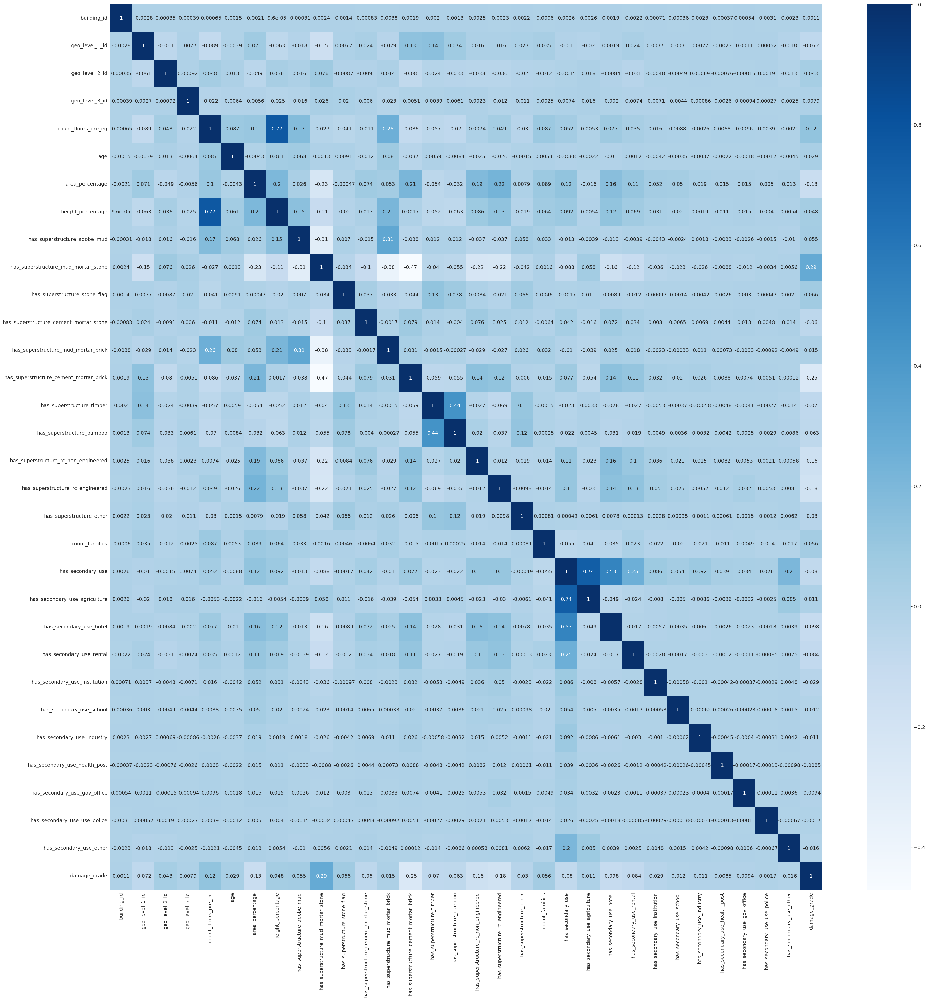

In [15]:
plt.figure(figsize=(45, 45))
sns.heatmap(data=raw_df.corr(),
            cmap='Blues',
            annot=True);

There not much strong correlation for the damage grade among the numeric features.

### Geographic Region - Largest(Level 1)

In [16]:
fig = px.histogram(raw_df,
                   x='geo_level_1_id',
                   color='damage_grade',
                   barmode='group',
                   title='Damage Grade for Largest Geographic Region')
fig.update_xaxes(dtick=1)
fig.show()

This is one the biggest feature for any disaster, the geographic location, the dataset contains location district wise going from larger to smaller area. The above plot shows and indicates larger district which will play a greater role in our prediction.

### Floor Count before Earthquake

In [17]:
raw_df.count_floors_pre_eq.describe()

count    260601.000000
mean          2.129723
std           0.727665
min           1.000000
25%           2.000000
50%           2.000000
75%           2.000000
max           9.000000
Name: count_floors_pre_eq, dtype: float64

In [18]:
fig = px.histogram(raw_df,
                   'count_floors_pre_eq',
                   color='damage_grade',
                   marginal='box',
                   barmode='group',
                   title='Building Damage Graded for Different Floors',
                   labels={'count_floors_pre_eq': 'Building Floors',
                           'damage_grade': 'Damage Grade'})
fig.update_layout(bargap=0.1, height=800)
fig.show()

Most of the floor of the building are within 3 floor which means that Nepal buildings were small in height and most likly a Bungalow owith a 1 or 2 storey height.

### Age

In [19]:
raw_df.age.describe()

count    260601.000000
mean         26.535029
std          73.565937
min           0.000000
25%          10.000000
50%          15.000000
75%          30.000000
max         995.000000
Name: age, dtype: float64

In [20]:
px.histogram(raw_df,
             x='age',
             color='damage_grade',
             labels={'age': 'Age (Years)',
                     'damage_grade': 'Damage Grade'},
             title='Structure Age and their Damage Grade')

Age feature in the dataset shows that most of the building were constructed in the last two decades and an outliner of 995 years indicates that some monuments were also damaged in the earthquake

### Area and Height Percentage

In [21]:
raw_df[['area_percentage','height_percentage']].describe()

,area_percentage,height_percentage
count,260601.000000,260601.000000
mean,8.018051,5.434365
std,4.392231,1.918418
min,1.000000,2.000000
25%,5.000000,4.000000
50%,7.000000,5.000000
75%,9.000000,6.000000
max,100.000000,32.000000


In [22]:
px.scatter(raw_df,
           x='area_percentage',
           y='height_percentage',
           color='damage_grade',
           color_continuous_scale=px.colors.sequential.YlOrRd,
           labels={'area_percentage': 'Area Percentage Normalized',
                   'height_percentage': 'Height Percentage Normalized',
                   'damage_grade': 'Damage Grade'},
           title='Area and Height of the Structure with Damage Grade')

This feature does not indicate any strong relations, just that building that were having weak ratio of area to height have seen similar damages.

### Families Count

In [23]:
raw_df.count_families.describe()

count    260601.000000
mean          0.983949
std           0.418389
min           0.000000
25%           1.000000
50%           1.000000
75%           1.000000
max           9.000000
Name: count_families, dtype: float64

In [24]:
fig = px.histogram(raw_df,
                   x='count_families',
                   color='damage_grade',
                   barmode='group',
                   title='Families Count with Damage Grade')
fig.update_xaxes(dtick=1)
fig.show()

Looking at this data we can guess this is related to the floor count features, where most of the families have their own bunglow.<br>
This is why 1 famaily count has higher damages.

## Data Preparation for Training Dataset

Now, that we have understood our data it time to preprare it for processing and modeling.<br>
The dataset is a clean dataset, where some of the columns are already one-hot encoded, still some more processing is needed like the scaling of numeric columns and one-hot encoding the categorical columns.<br>
We will also split the data in a ratio of 75:25 into a training and validation dataset.

### Input and Target Data

In [25]:
# Selecting the input and target data
input_cols, target_col = raw_df.columns[1:-1], raw_df.columns[-1]
inputs_df, target = raw_df[input_cols].copy(), raw_df[target_col].copy()

### Identifying numeric and categorical columns

In [26]:
# Creating a list of numeric and categorical columns
numeric_cols = raw_df[input_cols].select_dtypes(include=np.number).columns.tolist()
categorical_cols = raw_df[input_cols].select_dtypes(include='object').columns.tolist()

print(f'Numeric Columns: {numeric_cols}\n')
print(f'Categorical Columns: {categorical_cols}')

Numeric Columns: ['geo_level_1_id', 'geo_level_2_id', 'geo_level_3_id', 'count_floors_pre_eq', 'age', 'area_percentage', 'height_percentage', 'has_superstructure_adobe_mud', 'has_superstructure_mud_mortar_stone', 'has_superstructure_stone_flag', 'has_superstructure_cement_mortar_stone', 'has_superstructure_mud_mortar_brick', 'has_superstructure_cement_mortar_brick', 'has_superstructure_timber', 'has_superstructure_bamboo', 'has_superstructure_rc_non_engineered', 'has_superstructure_rc_engineered', 'has_superstructure_other', 'count_families', 'has_secondary_use', 'has_secondary_use_agriculture', 'has_secondary_use_hotel', 'has_secondary_use_rental', 'has_secondary_use_institution', 'has_secondary_use_school', 'has_secondary_use_industry', 'has_secondary_use_health_post', 'has_secondary_use_gov_office', 'has_secondary_use_use_police', 'has_secondary_use_other']

Categorical Columns: ['land_surface_condition', 'foundation_type', 'roof_type', 'ground_floor_type', 'other_floor_type', 'posi

### Scaling the Numeric Columns

In [27]:
# Min and Max values of numeric columns
raw_df.describe().loc[['min', 'max']]

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,damage_grade
min,4.0,0.0,0.0,0.0,1.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
max,1052934.0,30.0,1427.0,12567.0,9.0,995.0,100.0,32.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,9.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0


In [28]:
# Scaling the column values between 0 and 1.
scaler = MinMaxScaler().fit(inputs_df[numeric_cols])
inputs_df[numeric_cols] = scaler.transform(inputs_df[numeric_cols])
inputs_df[numeric_cols].describe().loc[['min', 'max']]

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


### One Hot Encoding the Categorical Columns

In [29]:
encoder = OneHotEncoder(sparse_output=False,
                        handle_unknown='ignore').fit(inputs_df[categorical_cols])
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))
inputs_df[encoded_cols] = encoder.transform(inputs_df[categorical_cols])
inputs_df.head()

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,land_surface_condition_n,land_surface_condition_o,land_surface_condition_t,foundation_type_h,foundation_type_i,foundation_type_r,foundation_type_u,foundation_type_w,roof_type_n,roof_type_q,roof_type_x,ground_floor_type_f,ground_floor_type_m,ground_floor_type_v,ground_floor_type_x,ground_floor_type_z,other_floor_type_j,other_floor_type_q,other_floor_type_s,other_floor_type_x,position_j,position_o,position_s,position_t,plan_configuration_a,plan_configuration_c,plan_configuration_d,plan_configuration_f,plan_configuration_m,plan_configuration_n,plan_configuration_o,plan_configuration_q,plan_configuration_s,plan_configuration_u,legal_ownership_status_a,legal_ownership_status_r,legal_ownership_status_v,legal_ownership_status_w
0,0.200000,0.341275,0.970637,0.125,0.030151,0.050505,0.100000,t,r,n,f,q,t,d,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,v,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.266667,0.630694,0.223761,0.125,0.010050,0.070707,0.166667,o,r,n,x,q,s,d,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,v,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.700000,0.254380,0.714013,0.125,0.010050,0.040404,0.100000,t,r,n,f,x,t,d,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,v,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.733333,0.292922,0.850959,0.125,0.010050,0.050505,0.100000,t,r,n,f,x,s,d,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,v,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.366667,0.091801,0.118405,0.250,0.030151,0.070707,0.233333,t,r,n,f,x,s,d,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,v,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


### Creating Training and Validation Split

In [30]:
train_inputs, val_inputs, train_target, val_target = train_test_split(inputs_df[numeric_cols + encoded_cols],
                                                                      target,
                                                                      test_size=0.25,
                                                                      random_state=42)
len(train_inputs), len(val_inputs), len(train_target), len(val_target)

(195450, 65151, 195450, 65151)

## Data preparation for Testing Dataset

We will apply the same processing to the test dataset, this will help in working it on the go while training the model.

In [31]:
# Transforming the test dataset
test_df[numeric_cols] = scaler.transform(test_df[numeric_cols])
test_df[encoded_cols] = encoder.transform(test_df[categorical_cols])
test_df.head()

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,land_surface_condition_n,land_surface_condition_o,land_surface_condition_t,foundation_type_h,foundation_type_i,foundation_type_r,foundation_type_u,foundation_type_w,roof_type_n,roof_type_q,roof_type_x,ground_floor_type_f,ground_floor_type_m,ground_floor_type_v,ground_floor_type_x,ground_floor_type_z,other_floor_type_j,other_floor_type_q,other_floor_type_s,other_floor_type_x,position_j,position_o,position_s,position_t,plan_configuration_a,plan_configuration_c,plan_configuration_d,plan_configuration_f,plan_configuration_m,plan_configuration_n,plan_configuration_o,plan_configuration_q,plan_configuration_s,plan_configuration_u,legal_ownership_status_a,legal_ownership_status_r,legal_ownership_status_v,legal_ownership_status_w
0,300051,0.566667,0.417659,0.899737,0.250,0.020101,0.060606,0.133333,t,r,n,f,q,s,d,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,v,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,99355,0.200000,0.098809,0.953847,0.125,0.025126,0.121212,0.100000,t,r,n,f,q,s,d,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,v,0.111111,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,890251,0.733333,0.013315,0.799236,0.125,0.005025,0.030303,0.100000,t,r,n,f,q,s,d,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,v,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,745817,0.866667,0.027330,0.050370,0.000,0.000000,0.181818,0.033333,t,r,x,v,j,t,d,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,v,0.222222,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,421793,0.566667,0.202523,0.634201,0.250,0.015075,0.070707,0.166667,t,r,q,f,q,t,d,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,v,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [32]:
# Selecting only the necessary columns
test_for_pred_df = test_df[numeric_cols + encoded_cols]
test_for_pred_df

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,land_surface_condition_n,land_surface_condition_o,land_surface_condition_t,foundation_type_h,foundation_type_i,foundation_type_r,foundation_type_u,foundation_type_w,roof_type_n,roof_type_q,roof_type_x,ground_floor_type_f,ground_floor_type_m,ground_floor_type_v,ground_floor_type_x,ground_floor_type_z,other_floor_type_j,other_floor_type_q,other_floor_type_s,other_floor_type_x,position_j,position_o,position_s,position_t,plan_configuration_a,plan_configuration_c,plan_configuration_d,plan_configuration_f,plan_configuration_m,plan_configuration_n,plan_configuration_o,plan_configuration_q,plan_configuration_s,plan_configuration_u,legal_ownership_status_a,legal_ownership_status_r,legal_ownership_status_v,legal_ownership_status_w
0,0.566667,0.417659,0.899737,0.250,0.020101,0.060606,0.133333,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.200000,0.098809,0.953847,0.125,0.025126,0.121212,0.100000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.111111,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.733333,0.013315,0.799236,0.125,0.005025,0.030303,0.100000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.866667,0.027330,0.050370,0.000,0.000000,0.181818,0.033333,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.222222,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.566667,0.202523,0.634201,0.250,0.015075,0.070707,0.166667,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86863,0.133333,0.423966,0.288295,0.250,0.070352,0.191919,0.133333,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.111111,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
86864,0.333333,0.985985,0.947481,0.250,0.025126,0.050505,0.166667,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
86865,0.733333,0.796076,0.613671,0.000,0.0

## Modeling, Evaluating, Predicting and Submitting

Now, that the dataset is prepared we will be modeling different models and evaluating on the metric of F1 Score Micro.

It is been mentioned in the competition that the evaluation is done using the F1 Micro Performance Metric, you can read the details over [here](https://www.drivendata.org/competitions/57/nepal-earthquake/page/136/#performance-metric).

For simplicity, first we will intiate and create our model and evaluate it.<br>
Then we will perform the prediction on the test dataset and submit it on the DrivenData website and check our performance on the unknown data.

### Model - Decision Tree Classifier

Our first model is the Decision Tree Classifier, it's one of the best model for any baseline modeling and performance comparision.

In [33]:
# Intializing the model
tree_model = DecisionTreeClassifier(random_state=42)

In [34]:
# Fitting the model
tree_model.fit(X=train_inputs, y=train_target)

DecisionTreeClassifier(random_state=42)

In [35]:
# Predicting using the model
train_preds_tree_model = tree_model.predict(train_inputs)
train_preds_tree_model

array([2, 3, 2, ..., 2, 3, 2])

In [36]:
# Accuracy of the prediction
tree_model_train_acc = accuracy_score(y_true=train_target,
                                y_pred=train_preds_tree_model)
tree_model_train_acc

0.9875108723458685

In [37]:
# Lets test the model on validation data
tree_model_val_acc = tree_model.score(X=val_inputs, y=val_target)
tree_model_val_acc

0.6579638071556845

In [38]:
# Ground truth bifurcation
val_target.value_counts()/len(val_target)

2    0.567819
3    0.334761
1    0.097420
Name: damage_grade, dtype: float64

In [39]:
# prediction for validation data
val_preds_tree_model = tree_model.predict(val_inputs)
val_preds_tree_model

array([3, 2, 2, ..., 2, 3, 1])

In [40]:
# Calculating the f1 Score
tree_model_train_f1score = f1_score(y_true=train_target, y_pred=train_preds_tree_model, average='micro')
tree_model_val_f1score = f1_score(y_true=val_target, y_pred=val_preds_tree_model, average='micro')
tree_model_train_f1score, tree_model_val_f1score

(0.9875108723458685, 0.6579638071556845)

In [41]:
# Storing the result in dataframe
model_result_df = pd.DataFrame({'model_name': ['tree_model'],
                                'model_method': ['DecisionTreeClassifier'],
                                'train_acc_score': [tree_model_train_acc],
                                'val_acc_score': [tree_model_val_acc],
                                'train_f1_score': [tree_model_train_f1score],
                                'val_f1_score': [tree_model_val_f1score]})
model_result_df

,model_name,model_method,train_acc_score,val_acc_score,train_f1_score,val_f1_score
0,tree_model,DecisionTreeClassifier,0.987511,0.657964,0.987511,0.657964


This is a really good score for default parameters and a good one for our starting point as a baseline score.<br>
We can also see that there is overfitting because we haven't touched the parameters and the model has trained on all the training data throughly.

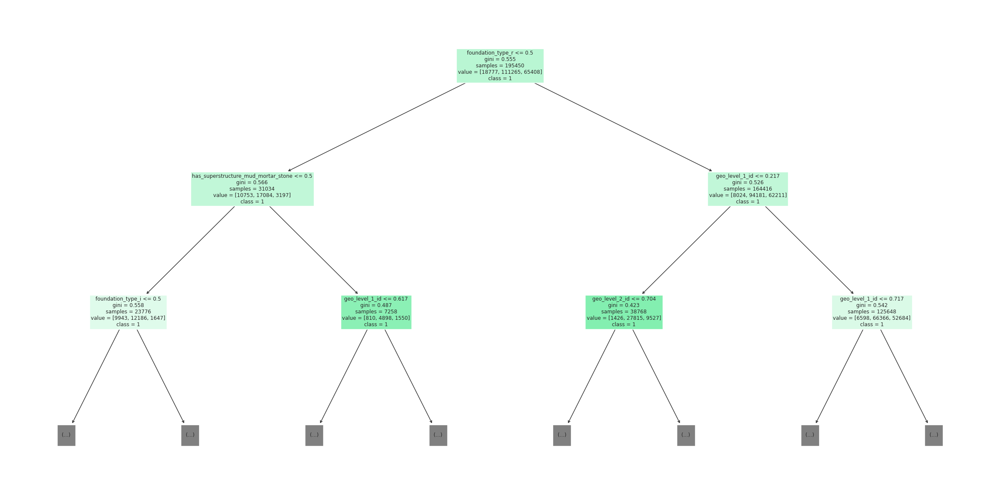

In [42]:
# Plotting the tree model
plt.figure(figsize=(30,15))
plot_tree(tree_model, feature_names=train_inputs.columns, max_depth=2, filled=True, class_names=str(tree_model.classes_));

In [43]:
# Visualizing the tree model in text format
print(export_text(tree_model, max_depth=10, feature_names=list(train_inputs.columns))[:2000])

|--- foundation_type_r <= 0.50
|   |--- has_superstructure_mud_mortar_stone <= 0.50
|   |   |--- foundation_type_i <= 0.50
|   |   |   |--- age <= 0.00
|   |   |   |   |--- geo_level_1_id <= 0.85
|   |   |   |   |   |--- has_superstructure_stone_flag <= 0.50
|   |   |   |   |   |   |--- has_superstructure_other <= 0.50
|   |   |   |   |   |   |   |--- other_floor_type_q <= 0.50
|   |   |   |   |   |   |   |   |--- has_superstructure_bamboo <= 0.50
|   |   |   |   |   |   |   |   |   |--- count_families <= 0.06
|   |   |   |   |   |   |   |   |   |   |--- geo_level_2_id <= 0.55
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 16
|   |   |   |   |   |   |   |   |   |   |--- geo_level_2_id >  0.55
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 9
|   |   |   |   |   |   |   |   |   |--- count_families >  0.06
|   |   |   |   |   |   |   |   |   |   |--- has_superstructure_cement_mortar_stone <= 0.50
|   |   |   |   |   |   |   |   |   |

In [44]:
# Check feature importance of the model
tree_model_importances = tree_model.feature_importances_
tree_importance_df = pd.DataFrame({'feature': train_inputs.columns,
                                   'importance': tree_model_importances}).sort_values('importance', ascending=False)
tree_importance_df[:10]

,feature,importance
0,geo_level_1_id,0.148063
2,geo_level_3_id,0.128481
4,age,0.123598
5,area_percentage,0.121233
1,geo_level_2_id,0.117406
6,height_percentage,0.057192
35,foundation_type_r,0.040717
18,count_families,0.026516
8,has_superstructure_mud_mortar_stone,0.016475
3,count_floors_pre_eq,0.015660


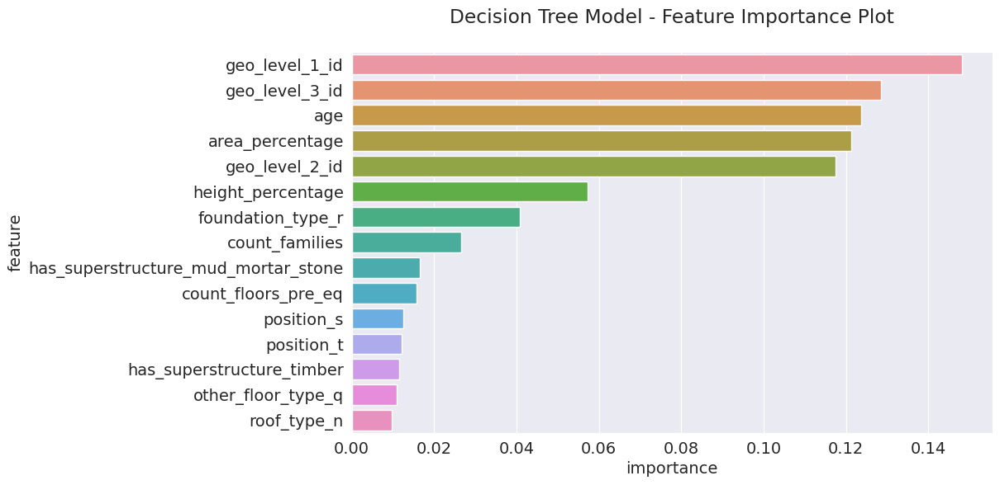

In [45]:
sns.barplot(data=tree_importance_df[:15], x='importance', y='feature')
plt.title('Decision Tree Model - Feature Importance Plot\n');

### Predict and Submit Test Dataset - Decision Tree Classifier

Now that training the model is done, lets check the result on the test dataset.

In [46]:
# making prediction for test dataset
test_pred_tree_model = tree_model.predict(test_for_pred_df)
test_pred_tree_model

array([2, 2, 3, ..., 3, 2, 2])

In [47]:
# prediction distribution
pd.value_counts(test_pred_tree_model)/len(test_pred_tree_model)

2    0.565732
3    0.335705
1    0.098563
dtype: float64

In [48]:
# Saving the prediction as per the format
test_result_tree_model = pd.DataFrame(data=test_pred_tree_model,
                                      columns=submission_format_df.columns,
                                      index=submission_format_df.index)
test_result_tree_model

,damage_grade
building_id,
300051,2
99355,2
890251,3
745817,2
421793,2
...,...
310028,1
663567,2
1049160,3


In [49]:
# Creating a folder for result
result_path = Path('result')
result_path.mkdir(parents=True, exist_ok=True)

# saving the result in a csv file
test_result_tree_model.to_csv(result_path/'tree_model_submission.csv')

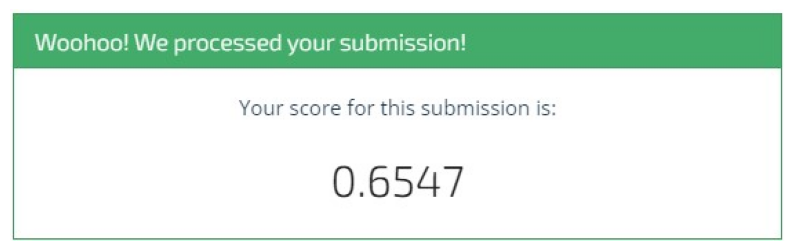

In [50]:
# Submitting to the competition and checking the result
urlretrieve(url='https://raw.githubusercontent.com/JohnPPinto/Modeling-Earthquake-Damage/main/result/tree_model_submission_result.jpg',
            filename=result_path/'tree_model_submission_result.jpg')
plt.imshow(plt.imread(result_path/'tree_model_submission_result.jpg'))
plt.axis(False);

In [51]:
# Adding the result to the dataframe
model_result_df['test_f1_score'] = 0.6547
model_result_df

,model_name,model_method,train_acc_score,val_acc_score,train_f1_score,val_f1_score,test_f1_score
0,tree_model,DecisionTreeClassifier,0.987511,0.657964,0.987511,0.657964,0.6547


Similar to the validation result, our test result gave the same score.<br>
Seeing this we can guess that if we improve our validation result, our test result will be close to that.

### Model No. 1 - Random Forest Classifier

Now, working on the second model, we will use an ensemble model, Random Forest Classifier.<br>
Random Forest Classifier is one of the famous model in the machine learning world.<br>
Let's test the performance of the model and see whether it will improve our current score.

In [52]:
# Creating the model
rf_model1 = RandomForestClassifier(n_jobs=-1, random_state=42)

# Fitting the model
rf_model1.fit(X=train_inputs, y=train_target)

RandomForestClassifier(n_jobs=-1, random_state=42)

In [53]:
# Checking the score for the train dataset
rf_model1_train_acc = rf_model1.score(X=train_inputs, y=train_target)
rf_model1_train_acc

0.9874955231517012

In [54]:
# score for val dataset
rf_model1_val_acc = rf_model1.score(X=val_inputs, y=val_target)
rf_model1_val_acc

0.7121609798775154

In [55]:
# Predicting for training and validation data
train_pred_rf_model1 = rf_model1.predict(train_inputs)
val_pred_rf_model1 = rf_model1.predict(val_inputs)
train_pred_rf_model1, val_pred_rf_model1

(array([2, 3, 2, ..., 2, 3, 2]), array([3, 2, 2, ..., 3, 3, 2]))

In [56]:
# F1 score for training and validation data
rf_model1_train_f1_score = f1_score(y_true=train_target, y_pred=train_pred_rf_model1, average='micro')
rf_model1_val_f1_score = f1_score(y_true=val_target, y_pred=val_pred_rf_model1, average='micro')
rf_model1_train_f1_score, rf_model1_val_f1_score

(0.9874955231517012, 0.7121609798775154)

In [57]:
# feature importance of random forest model
rf_model1_importances = rf_model1.feature_importances_
rf_model1_importances_df = pd.DataFrame({'feature': train_inputs.columns,
                                         'importance': rf_model1_importances}).sort_values('importance', ascending=False)
rf_model1_importances_df[:10]

,feature,importance
2,geo_level_3_id,0.152728
1,geo_level_2_id,0.134194
0,geo_level_1_id,0.133714
4,age,0.120026
5,area_percentage,0.113513
6,height_percentage,0.056634
18,count_families,0.024494
3,count_floors_pre_eq,0.016438
35,foundation_type_r,0.015373
8,has_superstructure_mud_mortar_stone,0.012922


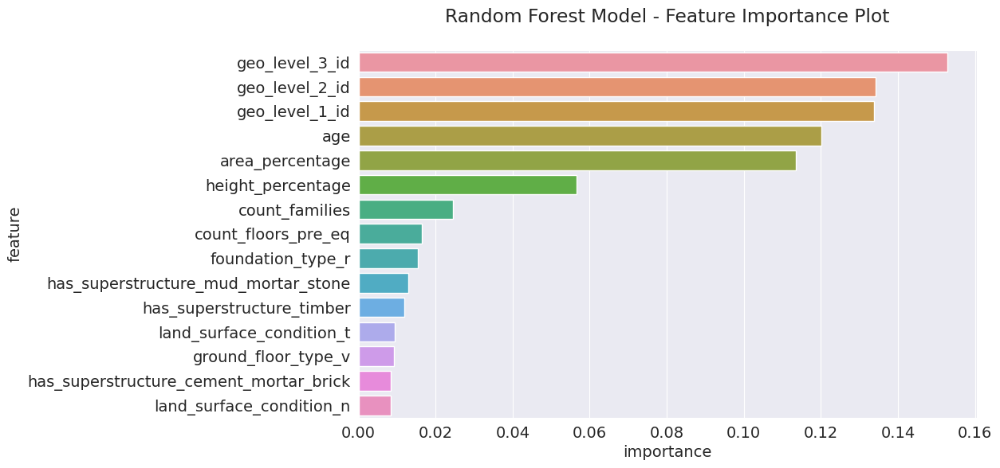

In [58]:
# Ploting top 15 feature importance
sns.barplot(data=rf_model1_importances_df[:15], x='importance', y='feature')
plt.title('Random Forest Model - Feature Importance Plot\n');

### Predict and Submit Test Dataset - Random Forest Classifier No. 1

In [59]:
# Predicting for test dataset
test_pred_rf_model1 = rf_model1.predict(test_for_pred_df)
test_pred_rf_model1

array([2, 2, 2, ..., 2, 2, 1])

In [60]:
# Saving the prediction as per the format
test_result_rf_model1 = pd.DataFrame(data=test_pred_rf_model1,
                                      columns=submission_format_df.columns,
                                      index=submission_format_df.index)
test_result_rf_model1

,damage_grade
building_id,
300051,2
99355,2
890251,2
745817,1
421793,3
...,...
310028,2
663567,2
1049160,2


In [61]:
# saving the result in a csv file
test_result_rf_model1.to_csv(result_path/'rf_model1_submission.csv')

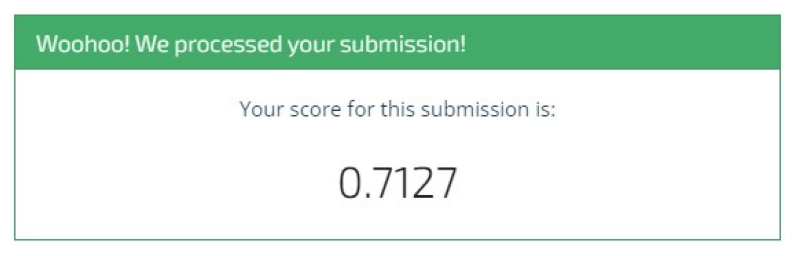

In [62]:
# Submitting to the competition and checking the result
urlretrieve(url='https://raw.githubusercontent.com/JohnPPinto/Modeling-Earthquake-Damage/main/result/rf_model1_submission_result.jpg',
            filename=result_path/'rf_model1_submission_result.jpg')
plt.imshow(plt.imread(result_path/'rf_model1_submission_result.jpg'))
plt.axis(False);

In [63]:
# Updating the result dataframe
rf_model1_test_f1_score = 0.7127

model_result_df.loc[len(model_result_df)] = ['rf_model1', 'RandomForestClassifier', rf_model1_train_acc, rf_model1_val_acc, rf_model1_train_f1_score, rf_model1_val_f1_score, rf_model1_test_f1_score]
model_result_df

,model_name,model_method,train_acc_score,val_acc_score,train_f1_score,val_f1_score,test_f1_score
0,tree_model,DecisionTreeClassifier,0.987511,0.657964,0.987511,0.657964,0.6547
1,rf_model1,RandomForestClassifier,0.987496,0.712161,0.987496,0.712161,0.7127


Random Forest Classifier has improved the score from 0.65 to 0.71 a 6 percent increase in the F1 Micro score.<br>
We can also see the the training score is at 99 percent which also means that the model is overfitting.

### Hyperparameter Tuning - Random Forests Classifier

Now, that we have see the potential of the Random Forest Model.<br>
It's time to work on the overfitting problem. In this step we will be experimenting on the hyperparameters and control the model trees learning potential and simultaneously imporve the validation score which will also lead to increase in test score.

In [64]:
# Creating a function to train a random forest model
def train_rf_model(**params):
    model = RandomForestClassifier(n_jobs=-1, random_state=42, **params)
    model.fit(X=train_inputs, y=train_target)
    train_pred = model.predict(train_inputs)
    val_pred = model.predict(val_inputs)
    train_f1_score = f1_score(y_true=train_target, y_pred=train_pred, average='micro')
    val_f1_score = f1_score(y_true=val_target, y_pred=val_pred, average='micro')
    return train_f1_score, val_f1_score 

In [65]:
# Testing the function
train_rf_model()

(0.9874955231517012, 0.7121609798775154)

In [66]:
train_rf_model(n_estimators=5)

(0.9515170120235354, 0.6760909272305874)

In [67]:
# Creating a function for training a parameter and plotting the result

def train_rf_model_plot(param_name, param_values):
    train_score, val_score = [], []
    
    # A training and validation loop for all the parameters
    for value in tqdm(param_values):
        params = {param_name: value}
        train_f1_score, val_f1_score = train_rf_model(**params)
        print(f'Parameter: {param_name} | Param Value: {value} | Training Score: {train_f1_score} | Validation Score: {val_f1_score} |')
        train_score.append(train_f1_score)
        val_score.append(val_f1_score)
    
    # Plotting the result
    plt.figure(figsize=(10, 6))
    plt.plot(param_values, train_score, 'b-o', label='Training')
    plt.plot(param_values, val_score, 'r-o', label='Validation')
    plt.title(f'Hyperparameters Tunning Curve: {param_name}')
    plt.xlabel(param_name)
    plt.ylabel('F1-Score')
    plt.legend()

#### n_estimators

  0%|          | 0/10 [00:00<?, ?it/s]

Parameter: n_estimators | Param Value: 1 | Training Score: 0.8547556919928371 | Validation Score: 0.6162146398366871 |
Parameter: n_estimators | Param Value: 51 | Training Score: 0.9872857508314147 | Validation Score: 0.710610735061626 |
Parameter: n_estimators | Param Value: 101 | Training Score: 0.9874955231517012 | Validation Score: 0.7123758652975396 |
Parameter: n_estimators | Param Value: 151 | Training Score: 0.9875108723458685 | Validation Score: 0.7132968028119292 |
Parameter: n_estimators | Param Value: 201 | Training Score: 0.9875108723458685 | Validation Score: 0.7128823809304539 |
Parameter: n_estimators | Param Value: 251 | Training Score: 0.9875108723458685 | Validation Score: 0.7133121517705023 |
Parameter: n_estimators | Param Value: 301 | Training Score: 0.9875108723458685 | Validation Score: 0.713281453853356 |
Parameter: n_estimators | Param Value: 351 | Training Score: 0.9875108723458685 | Validation Score: 0.7132200580190634 |
Parameter: n_estimators | Param Value

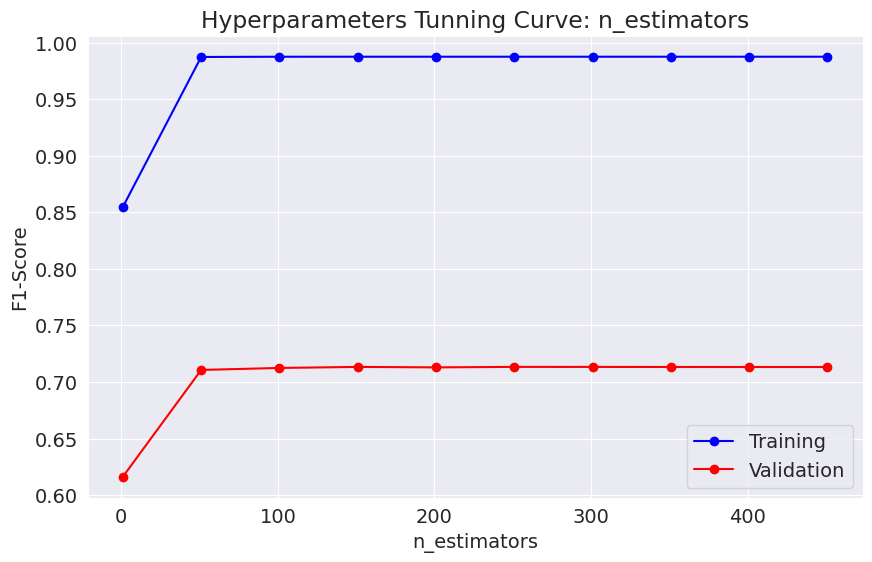

In [68]:
train_rf_model_plot(param_name='n_estimators', param_values=np.arange(1, 500, 50))

#### max_depth

  0%|          | 0/10 [00:00<?, ?it/s]

Parameter: max_depth | Param Value: 10 | Training Score: 0.6492350984906625 | Validation Score: 0.6429525256711333 |
Parameter: max_depth | Param Value: 15 | Training Score: 0.713138910207214 | Validation Score: 0.6773648907921598 |
Parameter: max_depth | Param Value: 20 | Training Score: 0.7903862880532105 | Validation Score: 0.6987459900845727 |
Parameter: max_depth | Param Value: 25 | Training Score: 0.8627168073676132 | Validation Score: 0.7091065371214562 |
Parameter: max_depth | Param Value: 30 | Training Score: 0.923607060629317 | Validation Score: 0.7144786726220625 |
Parameter: max_depth | Param Value: 35 | Training Score: 0.9616065489895114 | Validation Score: 0.7168731101594755 |
Parameter: max_depth | Param Value: 40 | Training Score: 0.979800460475825 | Validation Score: 0.7146782090835136 |
Parameter: max_depth | Param Value: 45 | Training Score: 0.9858224609874648 | Validation Score: 0.7123144694632468 |
Parameter: max_depth | Param Value: 50 | Training Score: 0.98741366

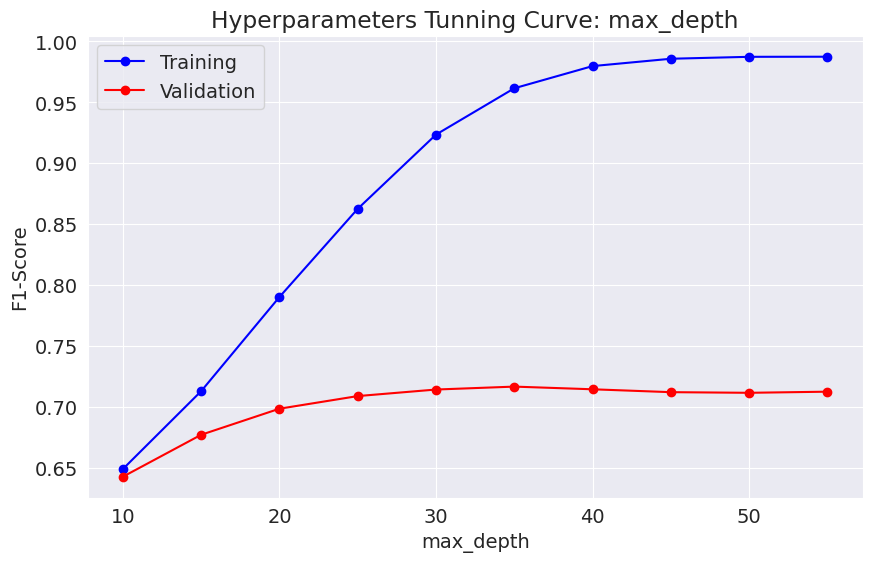

In [69]:
train_rf_model_plot(param_name='max_depth', param_values=np.arange(10, 60, 5))

#### max_leaf_nodes

  0%|          | 0/10 [00:00<?, ?it/s]

Parameter: max_leaf_nodes | Param Value: 8192 | Training Score: 0.7901151189562547 | Validation Score: 0.7095977037957976 |
Parameter: max_leaf_nodes | Param Value: 10321 | Training Score: 0.8078434382194934 | Validation Score: 0.712222375711808 |
Parameter: max_leaf_nodes | Param Value: 13003 | Training Score: 0.8280992581222819 | Validation Score: 0.7149391413792573 |
Parameter: max_leaf_nodes | Param Value: 16384 | Training Score: 0.851128165771297 | Validation Score: 0.718147073721048 |
Parameter: max_leaf_nodes | Param Value: 20642 | Training Score: 0.8758557175748273 | Validation Score: 0.7184694018510844 |
Parameter: max_leaf_nodes | Param Value: 26007 | Training Score: 0.9041647480173958 | Validation Score: 0.7202959279212905 |
Parameter: max_leaf_nodes | Param Value: 32768 | Training Score: 0.9340189306728064 | Validation Score: 0.7200196466669737 |
Parameter: max_leaf_nodes | Param Value: 41285 | Training Score: 0.9630033256587363 | Validation Score: 0.7192061518625962 |
Para

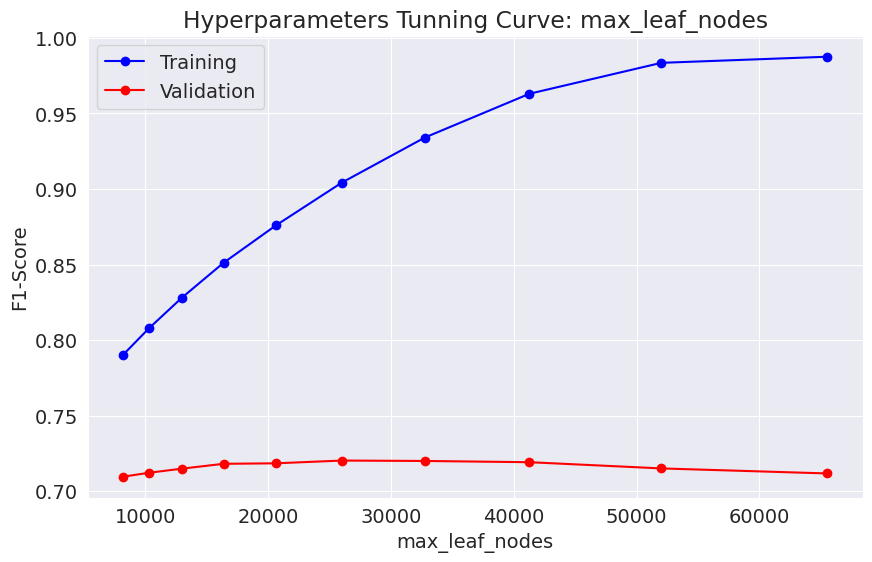

In [70]:
train_rf_model_plot(param_name='max_leaf_nodes', param_values=np.logspace(13, 16, base=2, num=10, dtype='int'))

#### min_samples_split

  0%|          | 0/14 [00:00<?, ?it/s]

Parameter: min_samples_split | Param Value: 2 | Training Score: 0.9874955231517012 | Validation Score: 0.7121609798775154 |
Parameter: min_samples_split | Param Value: 4 | Training Score: 0.9598772064466615 | Validation Score: 0.71975871437123 |
Parameter: min_samples_split | Param Value: 6 | Training Score: 0.9247684829879764 | Validation Score: 0.7221991987843625 |
Parameter: min_samples_split | Param Value: 8 | Training Score: 0.8985264773599386 | Validation Score: 0.7240103758959955 |
Parameter: min_samples_split | Param Value: 10 | Training Score: 0.8777948324379637 | Validation Score: 0.7238415373516907 |
Parameter: min_samples_split | Param Value: 12 | Training Score: 0.8630237912509593 | Validation Score: 0.721477797731424 |
Parameter: min_samples_split | Param Value: 14 | Training Score: 0.8504783832182143 | Validation Score: 0.72330432380163 |
Parameter: min_samples_split | Param Value: 16 | Training Score: 0.8392018419033 | Validation Score: 0.7215391935657166 |
Parameter: m

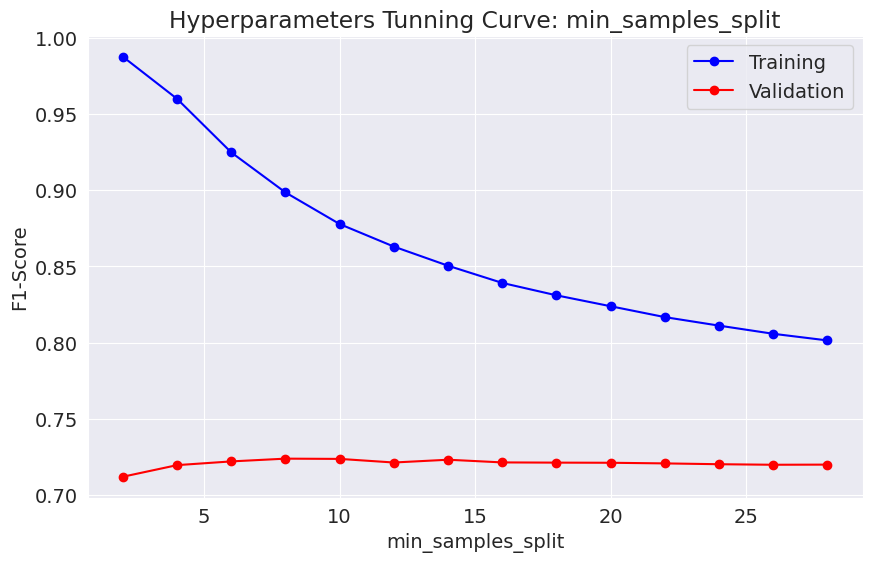

In [71]:
train_rf_model_plot(param_name='min_samples_split', param_values=np.arange(2, 30, 2))

#### min_samples_leaf

  0%|          | 0/10 [00:00<?, ?it/s]

Parameter: min_samples_leaf | Param Value: 1 | Training Score: 0.9874955231517012 | Validation Score: 0.7121609798775154 |
Parameter: min_samples_leaf | Param Value: 2 | Training Score: 0.8448094141724226 | Validation Score: 0.7200042977084004 |
Parameter: min_samples_leaf | Param Value: 3 | Training Score: 0.7973036582246099 | Validation Score: 0.7159828705622323 |
Parameter: min_samples_leaf | Param Value: 4 | Training Score: 0.7737784599641853 | Validation Score: 0.7099814277601265 |
Parameter: min_samples_leaf | Param Value: 5 | Training Score: 0.7602814018930673 | Validation Score: 0.7093060735829074 |
Parameter: min_samples_leaf | Param Value: 6 | Training Score: 0.7503402404707086 | Validation Score: 0.7072032662583844 |
Parameter: min_samples_leaf | Param Value: 7 | Training Score: 0.7434996162701458 | Validation Score: 0.7036730057865573 |
Parameter: min_samples_leaf | Param Value: 8 | Training Score: 0.735886415963162 | Validation Score: 0.7018464797163513 |
Parameter: min_sa

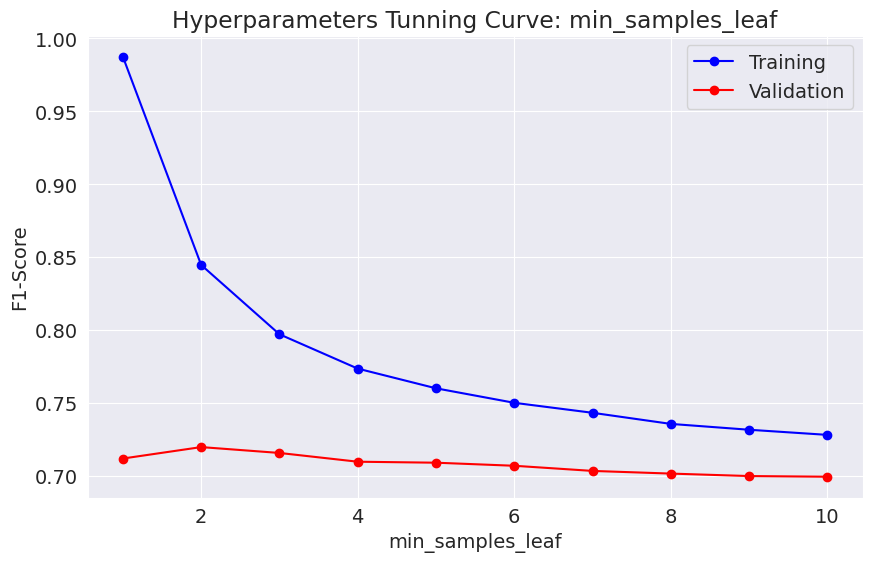

In [72]:
train_rf_model_plot(param_name='min_samples_leaf', param_values=np.arange(1, 11, 1))

#### max_features

  0%|          | 0/10 [00:00<?, ?it/s]

Parameter: max_features | Param Value: 0.1 | Training Score: 0.9875057559478128 | Validation Score: 0.7080474589799082 |
Parameter: max_features | Param Value: 0.2 | Training Score: 0.9874955231517012 | Validation Score: 0.7177326518395727 |
Parameter: max_features | Param Value: 0.30000000000000004 | Training Score: 0.9874904067536454 | Validation Score: 0.7218154748200335 |
Parameter: max_features | Param Value: 0.4 | Training Score: 0.9874904067536454 | Validation Score: 0.7242252613160197 |
Parameter: max_features | Param Value: 0.5 | Training Score: 0.9875057559478128 | Validation Score: 0.7245936363217755 |
Parameter: max_features | Param Value: 0.6 | Training Score: 0.9874801739575338 | Validation Score: 0.7246550321560682 |
Parameter: max_features | Param Value: 0.7000000000000001 | Training Score: 0.9874904067536454 | Validation Score: 0.7234117665116422 |
Parameter: max_features | Param Value: 0.8 | Training Score: 0.9874904067536454 | Validation Score: 0.7240871206888612 |
P

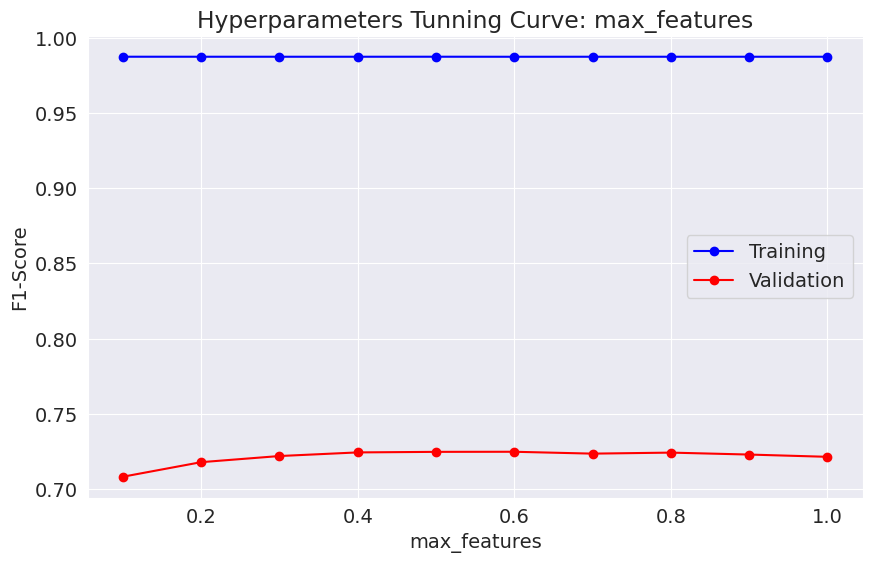

In [73]:
train_rf_model_plot(param_name='max_features', param_values=np.arange(0.1, 1.1, 0.1))

#### max_samples

  0%|          | 0/10 [00:00<?, ?it/s]

Parameter: max_samples | Param Value: 0.1 | Training Score: 0.7760552570990022 | Validation Score: 0.7089070006600052 |
Parameter: max_samples | Param Value: 0.2 | Training Score: 0.8344998720900485 | Validation Score: 0.716704271615171 |
Parameter: max_samples | Param Value: 0.30000000000000004 | Training Score: 0.8844512663085188 | Validation Score: 0.7189912664425718 |
Parameter: max_samples | Param Value: 0.4 | Training Score: 0.9241749808135072 | Validation Score: 0.7171800893309389 |
Parameter: max_samples | Param Value: 0.5 | Training Score: 0.9553236121770273 | Validation Score: 0.7179935841353164 |
Parameter: max_samples | Param Value: 0.6 | Training Score: 0.9746175492453313 | Validation Score: 0.7160135684793787 |
Parameter: max_samples | Param Value: 0.7000000000000001 | Training Score: 0.9837145049884881 | Validation Score: 0.7142484382434651 |
Parameter: max_samples | Param Value: 0.8 | Training Score: 0.9866717830647225 | Validation Score: 0.7134349434390876 |
Parameter:

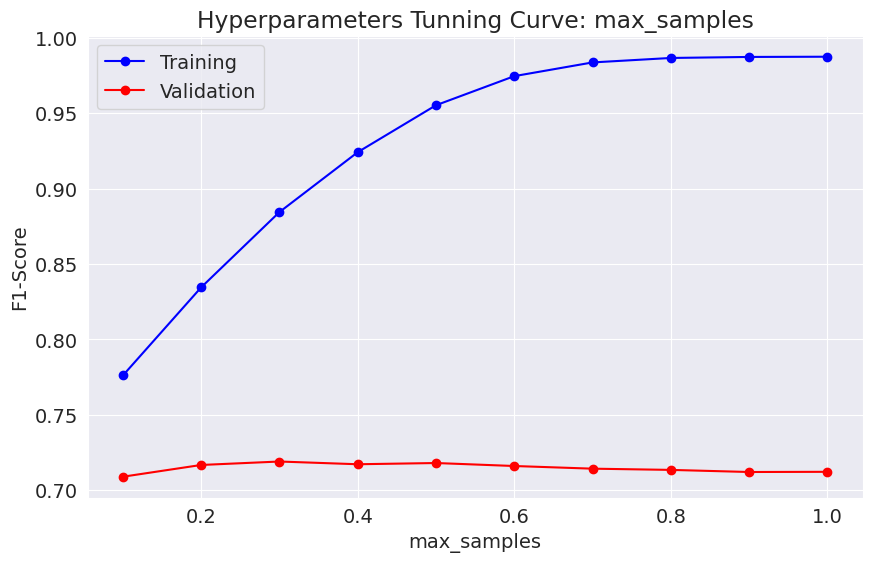

In [74]:
train_rf_model_plot(param_name='max_samples', param_values=np.arange(0.1, 1.1, 0.1))

We have performed a long experiment on our different parameters, looking at the above data we will select some of the values and perform a selection process for the Hyperparameters.<br>
We will use the GridSearchCV to help us locate the best parameters amoung all of the parameters values and then finalize our model hyperparameters.

#### Hyperparameter Tuning - GridSearchCV

In [75]:
# Creating a dictionary of selected parameters
param_grid = {'n_estimators': [250, 300],
              'max_depth': [35],
              'max_leaf_nodes': [27000, 28000],
              'min_samples_split': [8],
              'min_samples_leaf': [2],
              'max_samples': [0.3],
              'max_features': [1.0]}

In [76]:
# Performing grid search
grid_search = GridSearchCV(RandomForestClassifier(n_jobs=-1, random_state=42),
                           param_grid,
                           verbose=3)
grid_search.fit(train_inputs, train_target)
print(grid_search.best_estimator_)

Fitting 5 folds for each of 4 candidates, totalling 20 fits
[CV 1/5] END max_depth=35, max_features=1.0, max_leaf_nodes=27000, max_samples=0.3, min_samples_leaf=2, min_samples_split=8, n_estimators=250;, score=0.737 total time= 1.1min
[CV 2/5] END max_depth=35, max_features=1.0, max_leaf_nodes=27000, max_samples=0.3, min_samples_leaf=2, min_samples_split=8, n_estimators=250;, score=0.737 total time=  54.2s
[CV 3/5] END max_depth=35, max_features=1.0, max_leaf_nodes=27000, max_samples=0.3, min_samples_leaf=2, min_samples_split=8, n_estimators=250;, score=0.736 total time=  50.4s
[CV 4/5] END max_depth=35, max_features=1.0, max_leaf_nodes=27000, max_samples=0.3, min_samples_leaf=2, min_samples_split=8, n_estimators=250;, score=0.735 total time=  50.8s
[CV 5/5] END max_depth=35, max_features=1.0, max_leaf_nodes=27000, max_samples=0.3, min_samples_leaf=2, min_samples_split=8, n_estimators=250;, score=0.736 total time=  49.8s
[CV 1/5] END max_depth=35, max_features=1.0, max_leaf_nodes=27000

In [77]:
# Best parameters provided by GridSearchCV
print(grid_search.best_estimator_)

RandomForestClassifier(max_depth=35, max_features=1.0, max_leaf_nodes=27000,
                       max_samples=0.3, min_samples_leaf=2, min_samples_split=8,
                       n_estimators=250, n_jobs=-1, random_state=42)


GridSearchCV has provided the best parameters that will imporve the model training.<br>
We will start testing the model performance with different parameters and select the best one for our model.

#### Testing Hyperparameters 

In [78]:
train_rf_model(max_depth=35, max_leaf_nodes=27000, max_samples=0.3, min_samples_leaf=2, min_samples_split=8, n_estimators=300)

(0.7596060373497058, 0.7093521204586268)

In [79]:
train_rf_model(max_depth=35, max_leaf_nodes=27000, max_samples=0.5, min_samples_leaf=2, min_samples_split=8, n_estimators=250)

(0.7824814530570479, 0.7132507559362097)

In [80]:
train_rf_model(max_leaf_nodes=27000, max_samples=0.5, min_samples_leaf=2, min_samples_split=8, n_estimators=250)

(0.7878741366078281, 0.7155070528464643)

In [81]:
train_rf_model(max_leaf_nodes=27000, max_samples=0.5, min_samples_leaf=2, min_samples_split=8, n_estimators=250, max_features=0.8)

(0.8475466871322589, 0.7404491105278507)

In [82]:
train_rf_model(max_leaf_nodes=27000, max_samples=0.5, min_samples_leaf=2, min_samples_split=8, n_estimators=250, max_features=1.0)

(0.8483346124328472, 0.7410323709536308)

### Model No. 2 - Random Forest Classifier with Hyperparameter Tuning

After numerous experiments we have concluded our parameters and selected it to apply on the RandomForestClassifier and test the performance.

In [83]:
# Creating the model
rf_model2 = RandomForestClassifier(max_leaf_nodes=27000, 
                                   max_samples=0.5, 
                                   min_samples_leaf=2, 
                                   min_samples_split=8, 
                                   n_estimators=250, 
                                   max_features=1.0, 
                                   n_jobs=-1, 
                                   random_state=42)

# Fitting the model
rf_model2.fit(X=train_inputs, y=train_target)

RandomForestClassifier(max_features=1.0, max_leaf_nodes=27000, max_samples=0.5,
                       min_samples_leaf=2, min_samples_split=8,
                       n_estimators=250, n_jobs=-1, random_state=42)

In [84]:
# Checking the score for the train dataset
rf_model2_train_acc = rf_model2.score(X=train_inputs, y=train_target)
rf_model2_train_acc

0.8483346124328472

In [85]:
# Checking the score for the val dataset
rf_model2_val_acc = rf_model2.score(X=val_inputs, y=val_target)
rf_model2_val_acc

0.7410323709536308

In [86]:
# Predicting for training and validation data
train_pred_rf_model2 = rf_model2.predict(train_inputs)
val_pred_rf_model2 = rf_model2.predict(val_inputs)
train_pred_rf_model2, val_pred_rf_model2

(array([2, 3, 2, ..., 2, 3, 2]), array([3, 2, 2, ..., 2, 3, 2]))

In [87]:
# F1 score for training and validation data
rf_model2_train_f1_score = f1_score(y_true=train_target, y_pred=train_pred_rf_model2, average='micro')
rf_model2_val_f1_score = f1_score(y_true=val_target, y_pred=val_pred_rf_model2, average='micro')
rf_model2_train_f1_score, rf_model2_val_f1_score

(0.8483346124328472, 0.7410323709536308)

In [88]:
# feature importance of random forest model 2
rf_model2_importances = rf_model2.feature_importances_
rf_model2_importances_df = pd.DataFrame({'feature': train_inputs.columns,
                                         'importance': rf_model2_importances}).sort_values('importance', ascending=False)
rf_model2_importances_df[:10]

,feature,importance
0,geo_level_1_id,0.200780
2,geo_level_3_id,0.146343
1,geo_level_2_id,0.145306
4,age,0.091725
5,area_percentage,0.090416
35,foundation_type_r,0.055102
6,height_percentage,0.048299
8,has_superstructure_mud_mortar_stone,0.017854
18,count_families,0.016442
3,count_floors_pre_eq,0.013237


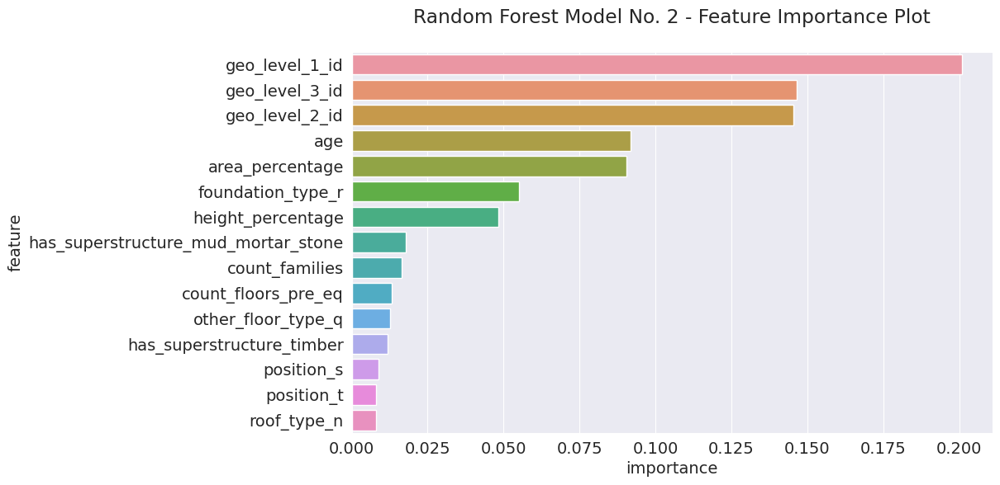

In [89]:
# Ploting top 15 feature importance
sns.barplot(data=rf_model2_importances_df[:15], x='importance', y='feature')
plt.title('Random Forest Model No. 2 - Feature Importance Plot\n');

### Predict and Submit Test Dataset - Random Forest Classifier No. 2

The training result is imporved and the we have reduced the overfitting, now lets check the testing result on the Driven Data website.

In [90]:
# Predicting for test dataset
test_pred_rf_model2 = rf_model2.predict(test_for_pred_df)
test_pred_rf_model2

array([3, 2, 2, ..., 2, 2, 2])

In [91]:
# Saving the prediction as per the format
test_result_rf_model2 = pd.DataFrame(data=test_pred_rf_model2,
                                     columns=submission_format_df.columns,
                                     index=submission_format_df.index)
test_result_rf_model2

,damage_grade
building_id,
300051,3
99355,2
890251,2
745817,1
421793,3
...,...
310028,2
663567,2
1049160,2


In [92]:
# saving the result in a csv file
test_result_rf_model2.to_csv(result_path/'rf_model2_submission.csv')

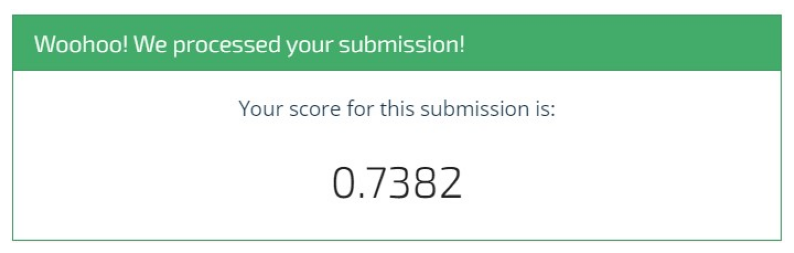

In [93]:
# Submitting to the competition and checking the result
urlretrieve(url='https://raw.githubusercontent.com/JohnPPinto/Modeling-Earthquake-Damage/main/result/rf_model2_submission_result.jpg',
            filename=result_path/'rf_model2_submission_result.jpg')
plt.imshow(plt.imread(result_path/'rf_model2_submission_result.jpg'))
plt.axis(False);

In [94]:
# Updating the result dataframe
rf_model2_test_f1_score = 0.7382

model_result_df.loc[len(model_result_df)] = ['rf_model2', 
                                             'RandomForestClassifier [max_leaf_nodes=27000, max_samples=0.5, min_samples_leaf=2, min_samples_split=8, n_estimators=250, max_features=1.0]', 
                                             rf_model2_train_acc, rf_model2_val_acc, rf_model2_train_f1_score, rf_model2_val_f1_score, rf_model2_test_f1_score]
model_result_df

,model_name,model_method,train_acc_score,val_acc_score,train_f1_score,val_f1_score,test_f1_score
0,tree_model,DecisionTreeClassifier,0.987511,0.657964,0.987511,0.657964,0.6547
1,rf_model1,RandomForestClassifier,0.987496,0.712161,0.987496,0.712161,0.7127
2,rf_model2,"RandomForestClassifier [max_leaf_nodes=27000, ...",0.848335,0.741032,0.848335,0.741032,0.7382


Finally, we have reduced the overfitting and improved the testing score by 2 percent which took us on the top 10% of the leaderboard.

## Saving the Best Model

Lets save our best model using the joblib library.

In [95]:
# Creating a Dictionary containing all the objects
earthquake_pkg_dict = {
    'model': rf_model2,
    'scaler': scaler,
    'encoder': encoder,
    'input_cols': input_cols,
    'target_cols': target_col,
    'encoded_cols': encoded_cols,
    'numeric_cols': numeric_cols,
    'categorical_cols': categorical_cols
}

# Saving the objects in a joblib file
joblib.dump(earthquake_pkg_dict, 'earthquake_pkg.joblib')

['earthquake_pkg.joblib']

## Loading and Testing the Best Model

Using the saved joblib file, let's test it whether is works as it is needed to.<br>
Along with that we will also test it on a single data. This will show the potential of the model to deploy it in the open world.

In [96]:
# Loading the saved model
loaded_model = joblib.load('earthquake_pkg.joblib')

In [97]:
# predicting using loaded model
loaded_model_val_pred = loaded_model['model'].predict(val_inputs)
loaded_model_val_pred

array([3, 2, 2, ..., 2, 3, 2])

In [98]:
# Score of the prediction
f1_score(y_true=val_target, y_pred=loaded_model_val_pred, average='micro')

0.7410323709536308

In [99]:
# Predicting on a single input
def predict_earthquake_damage(input_data: dict):
    input_df = pd.DataFrame([input_data])
    input_df[loaded_model['numeric_cols']] = loaded_model['scaler'].transform(input_df[loaded_model['numeric_cols']])
    input_df[loaded_model['encoded_cols']] = loaded_model['encoder'].transform(input_df[loaded_model['categorical_cols']])
    X = input_df[loaded_model['numeric_cols'] + loaded_model['encoded_cols']]
    pred = loaded_model['model'].predict(X)[0]
    pred_prob = loaded_model['model'].predict_proba(X)[0][list(loaded_model['model'].classes_).index(pred)]
    print(f'predicted damage grade: {pred} and prediction probability: {pred_prob:.4f}')
    return pred, pred_prob

In [100]:
# Getting sample data
rand_int = np.random.randint(0, len(raw_df))
input_data = dict(raw_df.loc[rand_int])
input_data

{'building_id': 960539,
 'geo_level_1_id': 17,
 'geo_level_2_id': 289,
 'geo_level_3_id': 3449,
 'count_floors_pre_eq': 4,
 'age': 15,
 'area_percentage': 9,
 'height_percentage': 9,
 'land_surface_condition': 't',
 'foundation_type': 'r',
 'roof_type': 'q',
 'ground_floor_type': 'f',
 'other_floor_type': 'q',
 'position': 't',
 'plan_configuration': 'd',
 'has_superstructure_adobe_mud': 0,
 'has_superstructure_mud_mortar_stone': 1,
 'has_superstructure_stone_flag': 0,
 'has_superstructure_cement_mortar_stone': 1,
 'has_superstructure_mud_mortar_brick': 0,
 'has_superstructure_cement_mortar_brick': 0,
 'has_superstructure_timber': 0,
 'has_superstructure_bamboo': 0,
 'has_superstructure_rc_non_engineered': 0,
 'has_superstructure_rc_engineered': 0,
 'has_superstructure_other': 0,
 'legal_ownership_status': 'v',
 'count_families': 1,
 'has_secondary_use': 1,
 'has_secondary_use_agriculture': 0,
 'has_secondary_use_hotel': 1,
 'has_secondary_use_rental': 0,
 'has_secondary_use_institutio

In [101]:
# Sample prediction for single data
predict_earthquake_damage(input_data)

predicted damage grade: 2 and prediction probability: 0.5291


(2, 0.5291189033189033)

## Conclusion

We have initiated and worked in modeling two different models namely Decision Tree and Random Forest Classifier to predict the damage grade of the destroyed building. 

The Random Forest Classifier Model is able to predict at 73 percent accuracy, which is 2 percent less compare to the best performer on the leaderboard.

**Dataset and Model Potential:**

The model and datset has the potential to be used not just for the aftermath of the earthquake, it can also help in indicating whether the current construction of the building is upto the mark for with standing a earthquake, with this dataset we can learn the negligence done while constructing different structures and ignoring the rules and policy set by the government bodies.

**Current Limitations**

Currently, we have only experimented with two models, we can use Gradient Boosting and Ensemble Method to imporve our models performance.<br>
We can also go deeper in our research and try to understand the categorical values true meaning, which is been not explained in the competetion. This might help in gaining some different insights and apply different types of feature engineering.
